In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
target = pd.read_csv('./data/0bf8bc6e-30d0-4c50-956a-603fc693d966.csv')
features = pd.read_csv('./data/4910797b-ee55-40a7-8668-10efd5c1b960.csv')

In [3]:
df = features.merge(target, on='id')

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 59400 entries, 0 to 59399
Data columns (total 41 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     59400 non-null  int64  
 1   amount_tsh             59400 non-null  float64
 2   date_recorded          59400 non-null  object 
 3   funder                 55765 non-null  object 
 4   gps_height             59400 non-null  int64  
 5   installer              55745 non-null  object 
 6   longitude              59400 non-null  float64
 7   latitude               59400 non-null  float64
 8   wpt_name               59400 non-null  object 
 9   num_private            59400 non-null  int64  
 10  basin                  59400 non-null  object 
 11  subvillage             59029 non-null  object 
 12  region                 59400 non-null  object 
 13  region_code            59400 non-null  int64  
 14  district_code          59400 non-null  int64  
 15  lg

<BarContainer object of 3 artists>

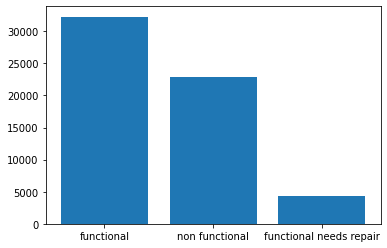

In [5]:
plt.bar(df.status_group.value_counts().index,df.status_group.value_counts().values)

In [6]:
top_funders = list(df.funder.value_counts().head(50).index)
df.funder.value_counts().head(50)

Government Of Tanzania            9084
Danida                            3114
Hesawa                            2202
Rwssp                             1374
World Bank                        1349
Kkkt                              1287
World Vision                      1246
Unicef                            1057
Tasaf                              877
District Council                   843
Dhv                                829
Private Individual                 826
Dwsp                               811
0                                  777
Norad                              765
Germany Republi                    610
Tcrs                               602
Ministry Of Water                  590
Water                              583
Dwe                                484
Netherlands                        470
Hifab                              450
Adb                                448
Lga                                442
Amref                              425
Fini Water               

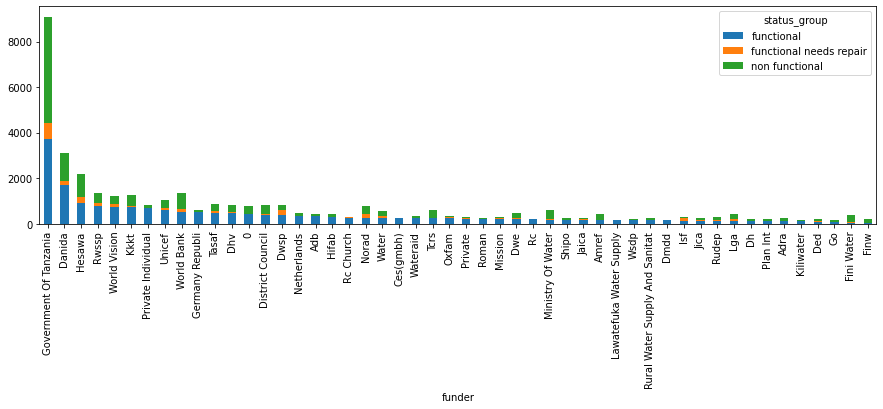

In [7]:
df.loc[df['funder'].isin(top_funders)].groupby('funder').status_group.value_counts().unstack()\
    .sort_values('functional',ascending=False).plot.bar(stacked=True)
fig = plt.gcf()
fig.set_figwidth(15)

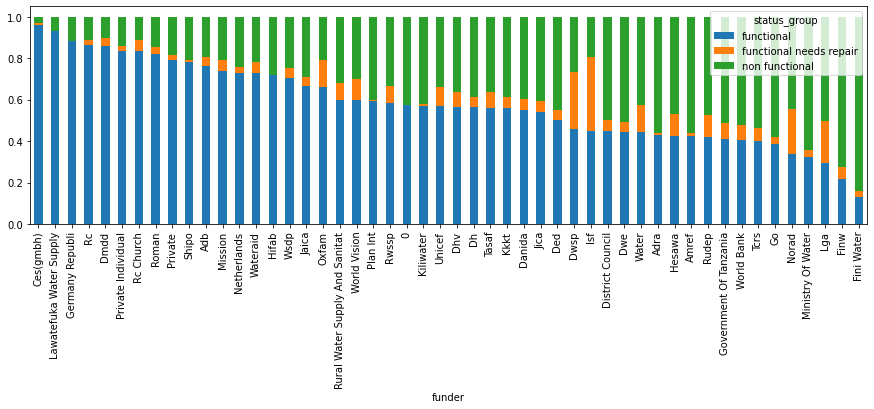

In [8]:
df.loc[df['funder'].isin(top_funders)].groupby('funder').status_group.value_counts(normalize=True).unstack()\
    .sort_values('functional',ascending=False).plot.bar(stacked=True)
fig = plt.gcf()
fig.set_figwidth(15)

In [9]:
top_installers = list(df.installer.value_counts().head(50).index)
df.installer.value_counts().head(50)

DWE                           17402
Government                     1825
RWE                            1206
Commu                          1060
DANIDA                         1050
KKKT                            898
Hesawa                          840
0                               777
TCRS                            707
Central government              622
CES                             610
Community                       553
DANID                           552
District Council                551
HESAWA                          539
World vision                    408
LGA                             408
WEDECO                          397
TASAF                           396
District council                392
Gover                           383
AMREF                           329
TWESA                           316
WU                              301
Dmdd                            287
ACRA                            278
World Vision                    270
SEMA                        

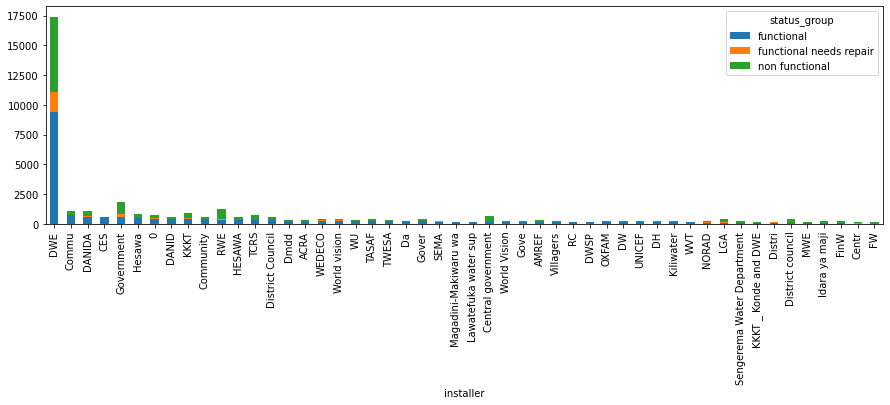

In [10]:
df.loc[df['installer'].isin(top_installers)].groupby('installer').status_group.value_counts().unstack()\
    .sort_values('functional',ascending=False).plot.bar(stacked=True)
fig = plt.gcf()
fig.set_figwidth(15)

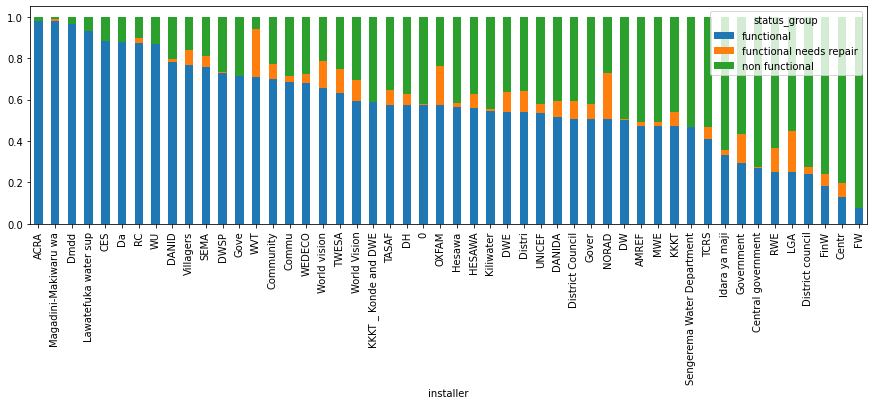

In [11]:
df.loc[df['installer'].isin(top_installers)].groupby('installer').status_group.value_counts(normalize=True).unstack()\
    .sort_values('functional',ascending=False).plot.bar(stacked=True)
fig = plt.gcf()
fig.set_figwidth(15)

vwc                 40507
wug                  6515
water board          2933
wua                  2535
private operator     1971
parastatal           1768
water authority       904
other                 844
company               685
unknown               561
other - school         99
trust                  78
Name: management, dtype: int64

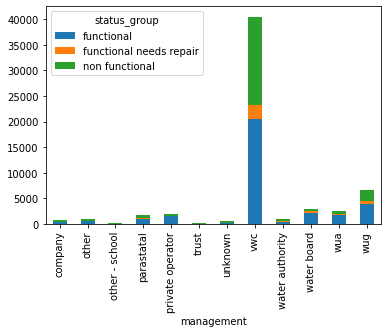

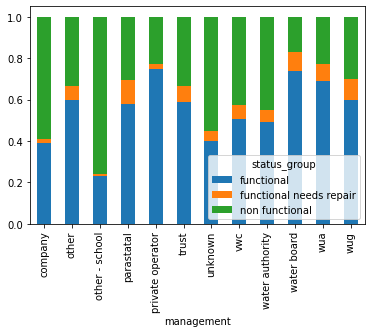

In [12]:
df.groupby('management').status_group.value_counts().unstack().plot.bar(stacked=True)
df.groupby('management').status_group.value_counts(normalize=True).unstack().plot.bar(stacked=True)
df.management.value_counts().head(50)

user-group    52490
commercial     3638
parastatal     1768
other           943
unknown         561
Name: management_group, dtype: int64

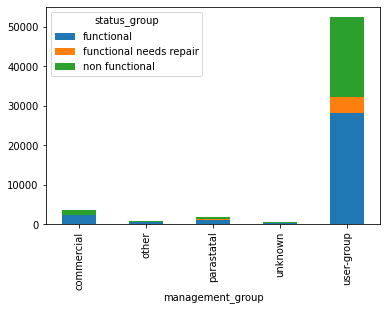

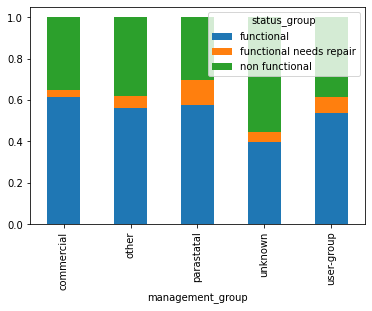

In [13]:
df.groupby('management_group').status_group.value_counts().unstack().plot.bar(stacked=True)
df.groupby('management_group').status_group.value_counts(normalize=True).unstack().plot.bar(stacked=True)
df.management_group.value_counts().head(50)

gravity         26780
handpump        16456
other            6430
submersible      6179
motorpump        2987
rope pump         451
wind-powered      117
Name: extraction_type_class, dtype: int64

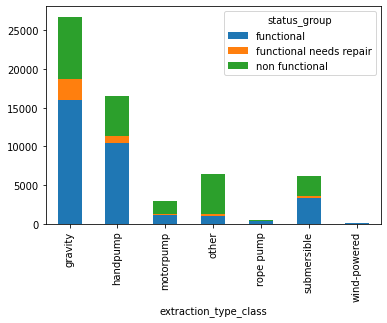

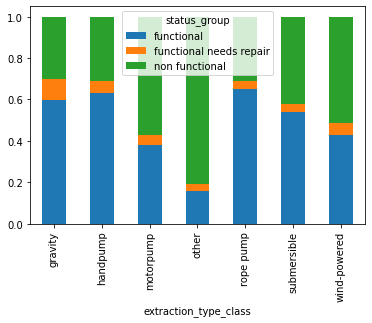

In [14]:
df.groupby('extraction_type_class').status_group.value_counts().unstack().plot.bar(stacked=True)
df.groupby('extraction_type_class').status_group.value_counts(normalize=True).unstack().plot.bar(stacked=True)
df.extraction_type_class.value_counts().head(50)

spring                  17021
shallow well            16824
machine dbh             11075
river                    9612
rainwater harvesting     2295
hand dtw                  874
lake                      765
dam                       656
other                     212
unknown                    66
Name: source, dtype: int64

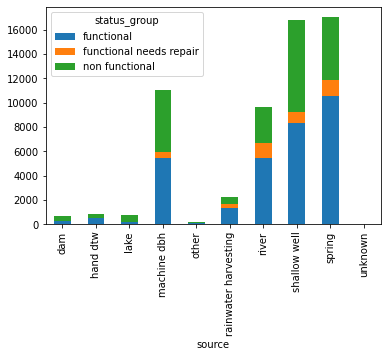

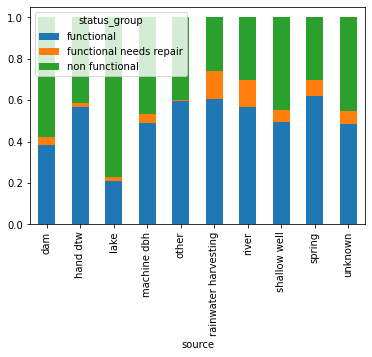

In [15]:
df.groupby('source').status_group.value_counts().unstack().plot.bar(stacked=True)
df.groupby('source').status_group.value_counts(normalize=True).unstack().plot.bar(stacked=True)
df.source.value_counts().head(50)

never pay                25348
pay per bucket            8985
pay monthly               8300
unknown                   8157
pay when scheme fails     3914
pay annually              3642
other                     1054
Name: payment, dtype: int64

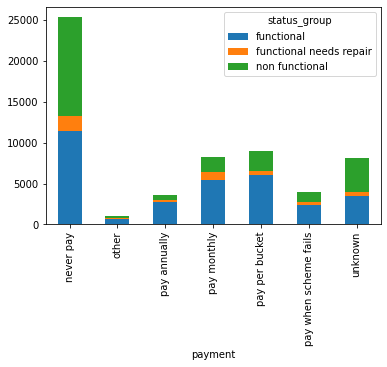

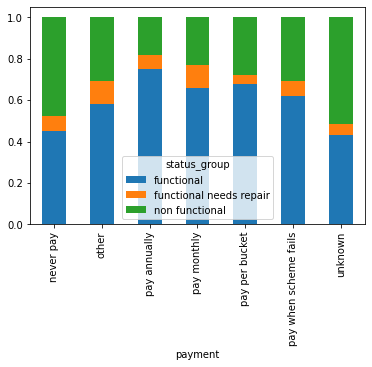

In [16]:
df.groupby('payment').status_group.value_counts().unstack().plot.bar(stacked=True)
df.groupby('payment').status_group.value_counts(normalize=True).unstack().plot.bar(stacked=True)
df.payment.value_counts()

soft                  50818
salty                  4856
unknown                1876
milky                   804
coloured                490
salty abandoned         339
fluoride                200
fluoride abandoned       17
Name: water_quality, dtype: int64

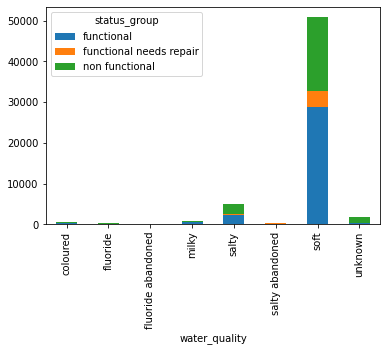

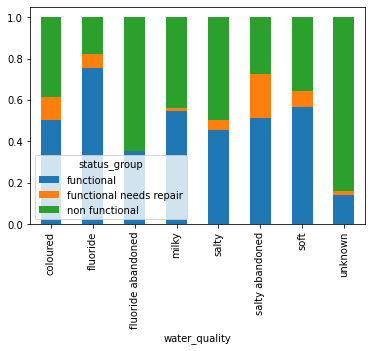

In [17]:
df.groupby('water_quality').status_group.value_counts().unstack().plot.bar(stacked=True)
df.groupby('water_quality').status_group.value_counts(normalize=True).unstack().plot.bar(stacked=True)
df.water_quality.value_counts()

Lake Victoria              10248
Pangani                     8940
Rufiji                      7976
Internal                    7785
Lake Tanganyika             6432
Wami / Ruvu                 5987
Lake Nyasa                  5085
Ruvuma / Southern Coast     4493
Lake Rukwa                  2454
Name: basin, dtype: int64

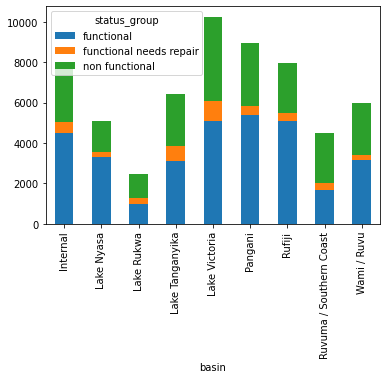

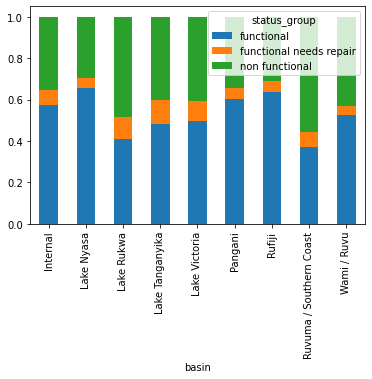

In [18]:
df.groupby('basin').status_group.value_counts().unstack().plot.bar(stacked=True)
df.groupby('basin').status_group.value_counts(normalize=True).unstack().plot.bar(stacked=True)
df.basin.value_counts()

enough          33186
insufficient    15129
dry              6246
seasonal         4050
unknown           789
Name: quantity, dtype: int64

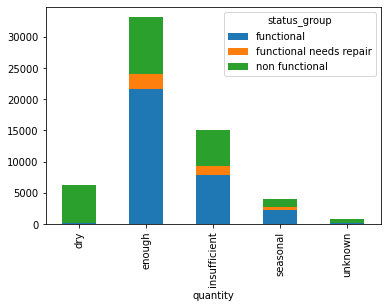

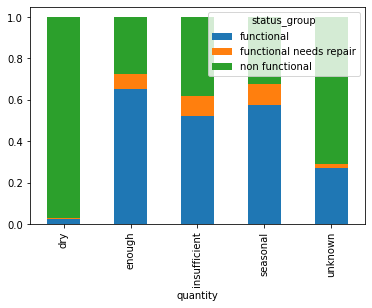

In [19]:
df.groupby('quantity').status_group.value_counts().unstack().plot.bar(stacked=True)
df.groupby('quantity').status_group.value_counts(normalize=True).unstack().plot.bar(stacked=True)
df.quantity.value_counts()

good        50818
salty        5195
unknown      1876
milky         804
colored       490
fluoride      217
Name: quality_group, dtype: int64

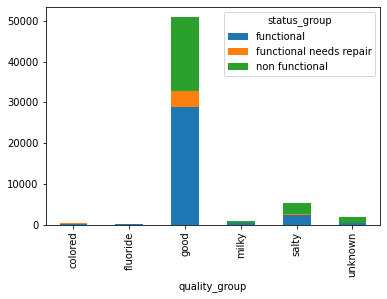

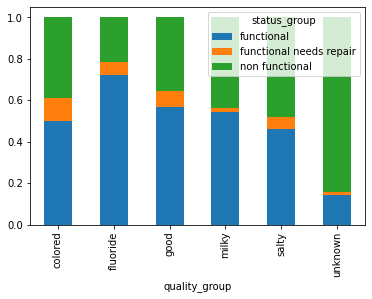

In [20]:
df.groupby('quality_group').status_group.value_counts().unstack().plot.bar(stacked=True)
df.groupby('quality_group').status_group.value_counts(normalize=True).unstack().plot.bar(stacked=True)
df.quality_group.value_counts()

In [21]:
df.describe()

,id,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year
count,59400.000000,59400.000000,59400.000000,59400.000000,5.940000e+04,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000
mean,37115.131768,317.650385,668.297239,34.077427,-5.706033e+00,0.474141,15.297003,5.629747,179.909983,1300.652475
std,21453.128371,2997.574558,693.116350,6.567432,2.946019e+00,12.236230,17.587406,9.633649,471.482176,951.620547
min,0.000000,0.000000,-90.000000,0.000000,-1.164944e+01,0.000000,1.000000,0.000000,0.000000,0.000000
25%,18519.750000,0.000000,0.000000,33.090347,-8.540621e+00,0.000000,5.000000,2.000000,0.000000,0.000000
50%,37061.500000,0.000000,369.000000,34.908743,-5.021597e+00,0.000000,12.000000,3.000000,25.000000,1986.000000
75%,55656.500000,20.000000,1319.250000,37.178387,-3.326156e+00,0.000000,17.000000,5.000000,215.000000,2004.000000
max,74247.000000,350000.000000,2770.000000,40.345193,-2.000000e-08,1776.000000,99.000000,80.000000,30500.000000,2013.000000


In [22]:
conditions = [
    df.construction_year == 0,
    (df.construction_year >= 1960) & (df.construction_year <1980),
    (df.construction_year >= 1980) & (df.construction_year <2000),
    df.construction_year >= 2000
]

choices = [0,1,2,3]

df['bin_year'] = np.select(conditions,choices)

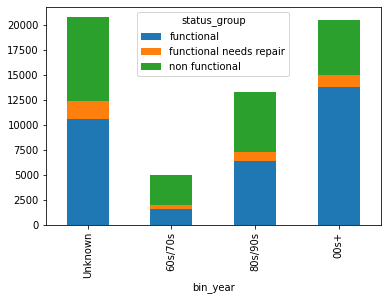

In [23]:
df.groupby('bin_year').status_group.value_counts().unstack().plot.bar(stacked=True)
ax = plt.gca()
ax.set_xticklabels(['Unknown','60s/70s','80s/90s','00s+']);

In [33]:
import geopandas as gpd
import folium

In [34]:
m = folium.Map(location=[-6.3690,34.8888], zoom_start=7)

df['coords'] = list(zip(df.latitude,df.longitude))

conditions = [df.status_group == 'functional',
              df.status_group == 'functional needs repair',
              df.status_group == 'non functional']

choices = ['blue','orange','green']

colors = np.select(conditions,choices)

for i, point in enumerate(df.coords):
    folium.CircleMarker(point,radius=.001,color=colors[i]).add_to(m)

m

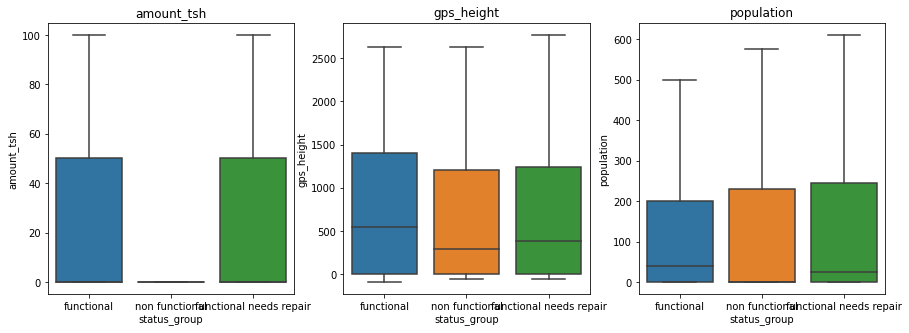

In [24]:
numeric = ['amount_tsh','gps_height','population']

fig, ax = plt.subplots(nrows=1,ncols=3,figsize=(15,5))

for i,col in enumerate(numeric):
    sns.boxplot(x='status_group',y=col,data=df,ax=ax[i], showfliers=False)
    ax[i].set_title(col)

In [25]:
df.groupby('public_meeting').status_group.value_counts().unstack()

status_group,functional,functional needs repair,non functional
public_meeting,,,
False,2173,442,2440
True,28408,3719,18884


In [26]:
df.groupby('permit').status_group.value_counts().unstack()

status_group,functional,functional needs repair,non functional
permit,,,
False,9045,1320,7127
True,21541,2697,14614


In [27]:
df.district_code.value_counts()

1     12203
2     11173
3      9998
4      8999
5      4356
6      4074
7      3343
8      1043
30      995
33      874
53      745
43      505
13      391
23      293
63      195
62      109
60       63
0        23
80       12
67        6
Name: district_code, dtype: int64

In [28]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 59400 entries, 0 to 59399
Data columns (total 42 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     59400 non-null  int64  
 1   amount_tsh             59400 non-null  float64
 2   date_recorded          59400 non-null  object 
 3   funder                 55765 non-null  object 
 4   gps_height             59400 non-null  int64  
 5   installer              55745 non-null  object 
 6   longitude              59400 non-null  float64
 7   latitude               59400 non-null  float64
 8   wpt_name               59400 non-null  object 
 9   num_private            59400 non-null  int64  
 10  basin                  59400 non-null  object 
 11  subvillage             59029 non-null  object 
 12  region                 59400 non-null  object 
 13  region_code            59400 non-null  int64  
 14  district_code          59400 non-null  int64  
 15  lg

In [29]:
df.waterpoint_type_group.value_counts()

communal standpipe    34625
hand pump             17488
other                  6380
improved spring         784
cattle trough           116
dam                       7
Name: waterpoint_type_group, dtype: int64

In [30]:
dummy_cols = ['funder', 'installer', 'basin', 'subvillage', 'region', 'lga',
       'ward','scheme_management', 'extraction_type_class',
       'management', 'management_group', 'payment', 'payment_type',
       'water_quality',  'quantity','source',  'waterpoint_type']

df = pd.get_dummies(df, columns=dummy_cols,drop_first=True)

In [35]:
to_drop = ['id','date_recorded','coords','recorded_by','wpt_name','num_private',
          'scheme_name','quantity_group','quality_group','source_type', 'source_class',
          'waterpoint_type_group','region_code', 'district_code']
df = df.drop(columns=to_drop,axis=1)

In [36]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 59400 entries, 0 to 59399
Columns: 25651 entries, amount_tsh to waterpoint_type_other
dtypes: float64(3), int64(4), object(5), uint8(25639)
memory usage: 1.4+ GB


In [37]:
from sklearn.model_selection import train_test_split

features = df.drop(columns=['status_group'],axis=1)
target = df.status_group

X_train, X_test, y_train, t_test = train_test_split(features,target,random_state=123) 

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

rfc = RandomForestClassifier(class_weight='balanced', random_state=123)

grid_params = {
    'n_estimators':[50,100,500],
    'max_depth': range(2,10,2),
    'min_samples_split': range(5,30,10),
    'max_leaf_nodes': range(15,35,10),
    'max_features': ['auto','sqrt',None],
    'max_samples': [None,.25,.5,.75]
}

forest_grid = GridSearchCV(
    rfc,
    grid_params,
    cv=5,
    verbose=1,
    n_jobs=-1,
    scoring='accuracy'
)

forest_results = forest_grid.fit(X_train)

Fitting 5 folds for each of 864 candidates, totalling 4320 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
